In [1]:
%cd ..

/workspaces/apartements


In [2]:
import pandas as pd
import numpy as np

pd.options.plotting.backend = "plotly"

In [3]:
df = pd.read_csv("assets/data/bolig.csv.gzip", compression="gzip", parse_dates=["soldDate"])
df.sample(4)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
25884,1832645,"Ole Jørgensens Gade 8, 2. tv",2200,2800000,2022-01-10 23:00:00+00:00,3,Alm. Salg,50909.090,2.0,55,...,-6.510851,CC5CEB31-237A-4A8D-8D44-8A435198A3D7,55.70043,12.541011,101,418499,København N,NaN,True,147444
30261,0,"Rebslagervej 7A, 3. tv",2400,44500000,2021-05-30 22:00:00+00:00,3,Alm. Salg,664179.100,2.0,67,...,0.000000,BA9B07B2-447F-49E9-A08A-5F7E3091A447,55.70257,12.536382,101,455130,København NV,2.0,True,8184449
3574,1702617,"Åboulevard 47, 2. th",1960,5425000,2020-09-10 22:00:00+00:00,3,Alm. Salg,44467.215,4.0,122,...,-1.273885,E0032F14-255B-4B97-B3C2-8FB40053B2B7,55.68498,12.549058,147,133510,Frederiksberg C,NaN,True,186162
6708,1398309,"Aksel Møllers Have 26, 5. tv",2000,3150000,2018-01-28 23:00:00+00:00,3,Alm. Salg,51639.344,2.0,61,...,0.000000,22EEA892-73FD-4C29-A859-6144025D3C92,55.68501,12.531571,147,4311,Frederiksberg,NaN,True,178623


In [4]:
df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr'],
      dtype='object')

In [5]:
# Sorting fam_salg away
SALES_TYPE = "Alm. Salg"
# Sorting apartments away that where sold for under 500.000 and above 9.000.000
LOWER_PRICE, HIGHER_PRICE = 450_000, 9_500_000

# Sorting apartments away that have above 5 roomes doe to the likelyhood of it being under 0.001%procent
NUMBER_OF_ROOMS = 5

# Number of Days from Max Date
DAYS_FROM_MAX_DATE = 31 + 30 + 31 + 30


alm_salg_df = (
    df.loc[
        (df["saleType"].eq(SALES_TYPE))
        & (df["price"].between(LOWER_PRICE, HIGHER_PRICE))
        & (df["rooms"].le(NUMBER_OF_ROOMS))
    ]
    .assign(
        floor=lambda d: d["address"]
        .str.extract(r",\s*(?P<floor>\d+|st)(?=\s*[a-z]*\.?\s|$)")
        .replace("st", 0)
        .fillna(0)
        .astype(int)
    )
    .assign(
        days_from_latest=lambda d: (d["soldDate"].max() - d["soldDate"]).dt.days
    )
    .sort_values(by="soldDate")
    .loc[lambda d: d["days_from_latest"] <= DAYS_FROM_MAX_DATE ]
)

(alm_salg_df
  .sample(5)
  .loc[:, ["price", "rooms", "size", "soldDate"]]
  .assign(soldAge = lambda d: (d["soldDate"].dt.date - pd.to_datetime("1991-01-01")).dt.days/365)
  .loc[:,["price", "rooms", "size", "soldAge"]] 
)

In [6]:
alm_salg_df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr', 'floor', 'days_from_latest'],
      dtype='object')

In [7]:
from pathlib import Path
import plotly.express as px

px.set_mapbox_access_token(Path("notebooks/.mapbox_token").read_text())

In [8]:
px.scatter_mapbox(
    alm_salg_df,
    lat="latitude",
    lon="longitude",
    color="size",
    size="price",
    color_continuous_scale=px.colors.cyclical.IceFire,
    size_max=5,
    zoom=11,
    title="Normal Sales Apartments in Copenhagen",
    hover_name="address",
    hover_data=["rooms", "buildYear", "floor"],
    center=dict(
        lat=55.6861,
        lon=12.5388,
    ),
    width=1200,
    height=800,
)

In [9]:
features = [
    "address",
    "zipCode",
    "soldDate",
    "rooms",
    "floor",
    "size",
    "buildYear",
    "latitude",
    "longitude",
    "municipalityCode",
    "estateCode",
    "city",
    "price",
]



In [10]:
explore_data = alm_salg_df[features].astype(
    {
        "rooms": np.int8,
        "size": np.int16,
        "buildYear": np.int32,
        "municipalityCode": np.int32,
        "estateCode": np.int32,
        "zipCode": np.int32,
    }
)
explore_data = (
    explore_data.assign(
        soldYear=lambda d: d["soldDate"].dt.year,
        soldMonth=lambda d: d["soldDate"].dt.month,
    ).drop(columns=["address", "soldDate"])

)

In [11]:
order_columns = [
    "price",
    "size",
    "rooms",
    "floor",
    "longitude",
    "latitude",
    "buildYear",
    "soldMonth",
    "soldYear",
    "zipCode",
    "city",
]

## Middle Age Tools

In [12]:
import hiplot as hip

In [13]:
explore_data.columns[::-1]

Index(['soldMonth', 'soldYear', 'price', 'city', 'estateCode',
       'municipalityCode', 'longitude', 'latitude', 'buildYear', 'size',
       'floor', 'rooms', 'zipCode'],
      dtype='object')

In [14]:
viz = hip.Experiment.from_dataframe(explore_data[order_columns])

In [15]:
viz.display();  # soldMonth has no effect & interestubg suze of 857, I think the correct is 85.7

<IPython.core.display.Javascript object>

In [16]:
explore_data = (
    explore_data
    #.drop(columns=["address", "soldDate"])
    # after the viz, we discovered Build Year 0 and size 857?
    .loc[lambda d: (d['buildYear'].ne(0))]
)

In [17]:
alm_salg_df_filtered = pd.merge(
    alm_salg_df[["address", "soldDate"]],
    explore_data,
    how="inner",
    left_index=True,
    right_index=True,
)

In [18]:
# alm_salg_df_filtered.loc[lambda d: d["floor"].gt(24)]

In [19]:
alm_salg_df_filtered.shape

(1317, 15)

In [20]:
interesting_columns = [
    "price",
    "size",
    "rooms",
    "floor",
    "longitude",
    "latitude",
    "buildYear",
    "soldYear",
    "zipCode",
    "city",
]

In [21]:
from sklearn.model_selection import train_test_split

In [22]:
X = explore_data[
    [
        "size",
        "rooms",
        "longitude",
        "latitude",
        "buildYear",
        "floor",
        "soldYear",
        "zipCode",
        "city",
    ]
]
y = explore_data["price"]

In [23]:
train_data = X.assign(price=y)

In [24]:
train_data.columns

Index(['size', 'rooms', 'longitude', 'latitude', 'buildYear', 'floor',
       'soldYear', 'zipCode', 'city', 'price'],
      dtype='object')

In [25]:
from sklearn.linear_model import LinearRegression
import patsy as ps

In [26]:
train_data.sample(2)

,size,rooms,longitude,latitude,buildYear,floor,soldYear,zipCode,city,price
17313,32,1,12.559529,55.704178,2002,2,2023,2100,København Ø,1845000
17581,66,2,12.577966,55.712890,1938,2,2023,2100,København Ø,2210001


In [27]:
# price ~ size

formula = (
    "price ~ size + C(rooms) + C(buildYear) + latitude + longitude - 1"
)

In [28]:
import warnings

with warnings.catch_warnings():
    warnings.simplefilter(action="ignore", category=FutureWarning)

    y_, X_ = ps.dmatrices(formula, data=train_data)

In [29]:
X_train, X_test, y_train, y_test = train_test_split(
    X_, y_, train_size=0.9, random_state=42
)
y_train, y_test = y_train.ravel(), y_test.ravel()

In [30]:
LinearRegression(n_jobs=-1).fit(X_train, y_train).score(X_test, y_test)

-3.4251624018920677e+19

In [31]:
from sklearn.neighbors import KNeighborsRegressor

In [32]:
KNeighborsRegressor(n_jobs=-1, n_neighbors=7).fit(X_train, y_train).score(
    X_test, y_test
)

0.6808533564939792

In [33]:
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor

In [34]:
GradientBoostingRegressor(
    learning_rate=0.7,
    n_estimators=107,
    random_state=42,
).fit(
    X_train, y_train
).score(X_test, y_test)

0.863074589559821

In [35]:
ExtraTreesRegressor(n_jobs=-1, 
                    n_estimators=107,
                    random_state=42,
                   ).fit(X_train, y_train).score(
    X_test, y_test
)

0.8529191344585347

In [36]:
from flaml import AutoML

In [37]:
automl = AutoML()

automl_settings = {
    "time_budget": 60 * 7,  # in seconds
    "metric": "rmse",
    "task": "regression",
    "log_file_name": "bolig.log",
    "estimator_list": [
        "xgboost",
        "lgbm",
        "catboost",
        "extra_tree",
    ],
    "sample": True,
    "n_jobs": -1,
}

automl.fit(X_train=X_train, y_train=y_train, **automl_settings)

[flaml.automl.logger: 12-28 14:00:01] {1679} INFO - task = regression
[flaml.automl.logger: 12-28 14:00:01] {1690} INFO - Evaluation method: cv
[flaml.automl.logger: 12-28 14:00:01] {1788} INFO - Minimizing error metric: rmse
[flaml.automl.logger: 12-28 14:00:01] {1900} INFO - List of ML learners in AutoML Run: ['xgboost', 'lgbm', 'catboost', 'extra_tree']
[flaml.automl.logger: 12-28 14:00:01] {2218} INFO - iteration 0, current learner xgboost
[flaml.automl.logger: 12-28 14:00:01] {2344} INFO - Estimated sufficient time budget=1658s. Estimated necessary time budget=2s.
[flaml.automl.logger: 12-28 14:00:01] {2391} INFO -  at 0.2s,	estimator xgboost's best error=1506294.4202,	best estimator xgboost's best error=1506294.4202
[flaml.automl.logger: 12-28 14:00:01] {2218} INFO - iteration 1, current learner lgbm
[flaml.automl.logger: 12-28 14:00:01] {2391} INFO -  at 0.4s,	estimator lgbm's best error=1503893.5797,	best estimator lgbm's best error=1503893.5797
[flaml.automl.logger: 12-28 14:0

In [38]:
automl.score(X_test, y_test)

0.8643089129222817

In [39]:
automl.best_estimator, automl.best_config_per_estimator.get(automl.best_estimator)

('lgbm',
 {'n_estimators': 1184,
  'num_leaves': 18,
  'min_child_samples': 3,
  'learning_rate': 0.027770046634702946,
  'log_max_bin': 10,
  'colsample_bytree': 0.5913535501508598,
  'reg_alpha': 0.0014365000506662193,
  'reg_lambda': 0.062040051601194385})

## End yet another

In [40]:

from sklearn.metrics import mean_squared_error, r2_score

In [41]:
%%time
y_pred = automl.predict(X_test).round(0).astype(int)
int(mean_squared_error(y_true=y_test, y_pred=y_pred, squared=False))

CPU times: user 15.3 ms, sys: 0 ns, total: 15.3 ms
Wall time: 9.22 ms


573104

In [42]:
# automlx is slow in scoring

In [43]:
import pickle

In [44]:
Path("notebooks/auto.pkl").write_bytes(
    pickle.dumps(automl, pickle.HIGHEST_PROTOCOL)
)

2414610

In [45]:
predictor = pickle.loads(Path("notebooks/auto.pkl").read_bytes()).model

In [46]:
predicted_price = predictor.predict(X_test).round(0).astype(int)

In [47]:
def restore_category(df, name):
    return (
        df[df.columns[df.columns.str.startswith(f"C({name})")]]
        .idxmax(axis=1)
        .str.extract(f"\[\.|(?P<{name}>\d+)\]")
        .astype(int)
    )

In [48]:
p = (
    pd.DataFrame(X_test, columns=X_.design_info.column_names)
    .assign(
        rooms=lambda d: restore_category(d, name="rooms"),
        buildYear=lambda d: restore_category(d, name="buildYear"),
        #soldYear=lambda d: restore_category(d, name="soldYear"),
        actual_price=y_test,
        predicted_price=predicted_price,
        residual=lambda d: d["predicted_price"] - d["actual_price"],
        under_estimate=lambda d: d["residual"] < 0,
    )
    # .sort_values(by=["actual_price", "predicted_price"]
    .loc[:, lambda d: d.columns[~d.columns.str.startswith("C(")]]
    .reset_index(drop=True)
)

In [49]:
(
    p.plot(
        kind="line",
        y="actual_price",
        title=f"True Sales v/ Predicted Sales",
    )
    .update_traces(line=dict(color="blue", width=3))
    .update_layout(
        hovermode="x unified",
        xaxis_title="Apartments",
        yaxis_title="Price",
    )
    # .add_traces(p.plot(kind="line", y="predicted_price")
    #            .update_traces(line = dict(color = 'black', width=2)
    #                                                                  ).data
    #           )
    .add_traces(
        p.plot(kind="area", y="predicted_price")
        .update_traces(
            line=dict(color="black", width=2),
            fill="tonexty",
            fillcolor='rgba(26,150,65,0.5)',
        )
        .data
    )
)

In [50]:
import plotly.graph_objects as go

# Assuming 'p' is already defined as shown
# No need to redefine the DataFrame

# Create the figure
fig = go.Figure()

# Add actual price trace
fig.add_trace(go.Scatter(
    x=p.index, 
    y=p['actual_price'],
    name='Actual Price',
    mode='lines',
    line=dict(color='blue', width=3)
))

# Add predicted prices trace with shaded area
fig.add_trace(go.Scatter(
    x=p.index, 
    y=p['predicted_price'],
    name='Predicted Prices',
    mode='lines',
    line=dict(color='grey', width=2),
    fill='tozeroy',
    fillcolor='rgba(26,150,65,0.5)'
))

# Update layout
fig.update_layout(
    title='True Sales vs Predicted Sales',
    xaxis_title='Apartments',
    yaxis_title='Price',
    hovermode='x unified'
)

# Show the plot
fig.show()

In [51]:
fig_size = {"width": 1200, "height": 400}
R2 = predictor.score(X_test, y_test).round(3)
RMSE = f"{int(mean_squared_error(y_true=y_test, y_pred=predicted_price, squared=False)):,}".replace(
    ",", "."
)

(
    p.plot(
        kind="scatter",
        y="residual",
        x=p.index,
        size="size",
        size_max=15,
        title=f"True Sales - Predicted Sales: {R2=} RMSE = DKK {RMSE}",
        **fig_size,
    )
    .add_hline(
        y=0,
        opacity=0.4,
    )
    .update_traces(mode="markers")
    .update_layout(hovermode="y")
)

In [52]:
# worst 5
p.assign(residual=lambda d: abs(d["residual"])).sort_values("residual").reset_index(
    drop=True
).iloc[-5:]

,size,latitude,longitude,rooms,buildYear,actual_price,predicted_price,residual,under_estimate
127,139.0,55.659700,12.633283,4,1962,7450000.0,8796971,1346971.0,False
128,113.0,55.668180,12.602139,3,2013,6100000.0,4606192,1493808.0,True
129,102.0,55.672170,12.532495,4,1908,7400000.0,5829283,1570717.0,True
130,73.0,55.681720,12.583391,2,1690,5045000.0,3025401,2019599.0,True
131,128.0,55.665016,12.579160,4,1970,5345000.0,7407118,2062118.0,False


In [53]:
# best 5
p.assign(residual=lambda d: abs(d["residual"])).sort_values("residual").reset_index(
    drop=True
).iloc[:5]

,size,latitude,longitude,rooms,buildYear,actual_price,predicted_price,residual,under_estimate
0,66.0,55.658080,12.621644,3,1940,2695000.0,2681510,13490.0,True
1,86.0,55.668900,12.509503,3,1932,3651000.0,3633335,17665.0,True
2,75.0,55.696520,12.597485,2,1994,4550000.0,4529821,20179.0,True
3,50.0,55.707120,12.588407,1,1935,2650000.0,2671839,21839.0,False
4,92.0,55.684822,12.490923,3,1981,3900000.0,3923919,23919.0,False


In [54]:
interesting_columns = [
    "actual_price",
    "predicted_price",
    "residual",
    "under_estimate",
    "size",
    "rooms",
    "longitude",
    "latitude",
    "buildYear",
   # "soldYear",
]

# The Chart to Rule them All

In [55]:
vis = hip.Experiment.from_dataframe(p[interesting_columns])
vis.display(force_full_width=True)

<IPython.core.display.Javascript object>

In [56]:
def to_int(df):
    columns = df.columns[df.columns.str.startswith("C(")]
    df[columns] = df[columns].astype(int)
    return df


dt = (pd
  .DataFrame(X_train, columns=X_.design_info.column_names)
  .assign(price=y_train)
  .pipe(to_int)
  
)


dv = (pd
  .DataFrame(X_test, columns=X_.design_info.column_names)
  .assign(price=y_test)
  .pipe(to_int)
  
)

In [57]:
import arviz as az
import pymc as pm

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [58]:
az.style.use("arviz-doc")
az.rcParams["plot.backend"] = "bokeh"
az.output_notebook()

Loading BokehJS ...

In [59]:
dt = (dt.assign(
    rooms=lambda d: restore_category(d, name="rooms"),
        buildYear=lambda d: restore_category(d, name="buildYear"),
     )
    .loc[:, lambda d: d.columns[~d.columns.str.startswith("C(")]]
    .reset_index(drop=True)
     )

dv = (dv.assign(
    rooms=lambda d: restore_category(d, name="rooms"),
        buildYear=lambda d: restore_category(d, name="buildYear"),
     )
    .loc[:, lambda d: d.columns[~d.columns.str.startswith("C(")]]
    .reset_index(drop=True)
)

In [60]:
dt

,size,latitude,longitude,price,rooms,buildYear
0,106.0,55.680183,12.560492,6300000.0,4,1938
1,77.0,55.706284,12.592242,4150000.0,2,2016
2,140.0,55.669987,12.498669,6995000.0,4,1976
3,84.0,55.697840,12.582155,5600000.0,2,1891
4,60.0,55.658703,12.520014,3000000.0,3,1902
...,...,...,...,...,...,...
1180,98.0,55.666035,12.583509,5525000.0,3,2005
1181,69.0,55.707363,12.583525,3750000.0,2,1916
1182,53.0,55.690746,12.499974,1850000.0,2,1935
1183,101.0,55.680397,12.493918,3750000.0,3,1991


In [61]:
import pymc as pm

In [62]:
with pm.Model() as model: 
    # Define priors
    sigma = pm.HalfCauchy("sigma", beta=10)
    intercept = pm.Normal("Intercept", 0, sigma=20)
    slope = pm.Normal("slope", 0, sigma=20)

    # data
    size = pm.MutableData('size', dt['size'], dims="obs_idx")
    log_price = np.log10(dt['price'])

    # Define likelihood
    likelihood = pm.Normal("price", mu=intercept + slope * size, sigma=sigma, observed=log_price, dims="obs_idx")

    # Inference!
    # draw 3000 posterior samples using NUTS sampling
    idata = pm.sample(5000)

ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Log(10.0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/virtualen


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_ol9m_luc


ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Cast{float64}(0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/vi


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_223w8c3r


ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Log(10.0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/virtualen


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_stf48h74


ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Cast{float64}(0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/vi


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_ey4ss0do


ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Log(10.0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/virtualen


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_s2ir6us6


ERROR (pytensor.graph.rewriting.basic): Rewrite failure due to: constant_folding
ERROR (pytensor.graph.rewriting.basic): node: Cast{float64}(0)
ERROR (pytensor.graph.rewriting.basic): TRACEBACK:
ERROR (pytensor.graph.rewriting.basic): Traceback (most recent call last):
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1922, in process_node
    replacements = node_rewriter.transform(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/graph/rewriting/basic.py", line 1082, in transform
    return self.fn(fgraph, node)
  File "/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/tensor/rewriting/basic.py", line 1105, in constant_folding
    thunk = node.op.make_thunk(node, storage_map, compute_map, no_recycling=[])
  File "/home/codespace/.cache/pypoetry/vi


You can find the C code in this temporary file: /tmp/pytensor_compilation_error_uk09hheo

You can find the C code in this temporary file: /tmp/pytensor_compilation_error_x3p9c9a6


CompileError: Compilation failed (return status=1):
/usr/bin/g++ -shared -g -Wno-c++11-narrowing -fno-exceptions -fno-unwind-tables -fno-asynchronous-unwind-tables -march=znver2 -mmmx -mno-3dnow -msse -msse2 -msse3 -mssse3 -msse4a -mcx16 -msahf -mmovbe -maes -msha -mpclmul -mpopcnt -mabm -mno-lwp -mfma -mno-fma4 -mno-xop -mbmi -mno-sgx -mbmi2 -mno-pconfig -mno-wbnoinvd -mno-tbm -mavx -mavx2 -msse4.2 -msse4.1 -mlzcnt -mno-rtm -mno-hle -mrdrnd -mf16c -mfsgsbase -mrdseed -mprfchw -madx -mfxsr -mxsave -mxsaveopt -mno-avx512f -mno-avx512er -mno-avx512cd -mno-avx512pf -mno-prefetchwt1 -mclflushopt -mxsavec -mxsaves -mno-avx512dq -mno-avx512bw -mno-avx512vl -mno-avx512ifma -mno-avx512vbmi -mno-avx5124fmaps -mno-avx5124vnniw -mclwb -mno-mwaitx -mclzero -mno-pku -mrdpid -mno-gfni -mshstk -mno-avx512vbmi2 -mno-avx512vnni -mvaes -mvpclmulqdq -mno-avx512bitalg -mno-avx512vpopcntdq -mno-movdiri -mno-movdir64b -mno-waitpkg -mno-cldemote -mno-ptwrite --param l1-cache-size=32 --param l1-cache-line-size=64 --param l2-cache-size=512 -mtune=znver2 -DNPY_NO_DEPRECATED_API=NPY_1_7_API_VERSION -m64 -fPIC -I/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/numpy/core/include -I/usr/local/python/3.10.13/include/python3.10 -I/home/codespace/.cache/pypoetry/virtualenvs/apartements-S6nTTcpo-py3.10/lib/python3.10/site-packages/pytensor/link/c/c_code -L/usr/local/python/3.10.13/lib -fvisibility=hidden -o /home/codespace/.pytensor/compiledir_Linux-6.2--azure-x86_64-with-glibc2.31-x86_64-3.10.13-64/lazylinker_ext/lazylinker_ext.so /home/codespace/.pytensor/compiledir_Linux-6.2--azure-x86_64-with-glibc2.31-x86_64-3.10.13-64/lazylinker_ext/mod.cpp -lpython3.10
/usr/bin/ld: /usr/local/python/3.10.13/lib/libpython3.10.a(bytearrayobject.o): relocation R_X86_64_PC32 against symbol `_Py_NoneStruct' can not be used when making a shared object; recompile with -fPIC
/usr/bin/ld: final link failed: bad value
collect2: error: ld returned 1 exit status


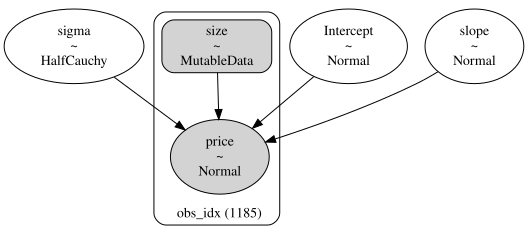

In [ ]:
pm.model_to_graphviz(model)

In [ ]:
az.plot_trace(idata, figsize=(10, 7));

NameError: name 'az' is not defined

In [ ]:
with model:
    pm.set_data({
        'size': dv['size'],
    })
    # Generate posterior predictive samples
    ppd_dv = pm.sample_posterior_predictive(idata, predictions=True)

NameError: name 'model' is not defined

In [ ]:
columns_order = ['size', 'latitude', 'longitude', 'rooms', 'buildYear',
              'price', 'pred_price', "residual"]

In [ ]:
pred_price = (10**ppd_dv.predictions["price"]).mean(dim=["chain", "draw"]).data.round(0)
dv = dv.assign(pred_price=pred_price,
              residual = lambda d: d["price"] - dv["pred_price"]).loc[:, columns_order]
dv

NameError: name 'ppd_dv' is not defined

In [ ]:
R2 = r2_score(dv["price"], dv["pred_price"]).round(3)
RMSE = f'{int(mean_squared_error(y_true=dv["price"], y_pred=dv["pred_price"], squared=False)):,}'.replace(
    ",", "."
)


(
    dv.plot(
        kind="line",
        y="price",
        title=f"Bayesian: True Sales v/ Predicted Sales: {R2=} RMSE = DKK {RMSE}",
    )
    .update_traces(line=dict(color="blue", width=3))
    .update_layout(
        hovermode="x unified",
        xaxis_title="Apartments",
        yaxis_title="Price",
    )
    .add_traces(
        dv.plot(kind="area", y="pred_price")
        .update_traces(
            line=dict(color="black", width=2,),
            fill="tonexty",
            fillcolor='rgba(26,150,65,0.5)',
        )
        .data
    )
)

KeyError: 'pred_price'

In [ ]:

(
    dv.plot(
        kind="scatter",
        y="residual",
        x=p.index,
        size="size",
        size_max=15,
        title=f"True Sales - Predicted Sales: {R2=} RMSE = DKK {RMSE}",
        **fig_size,
    )
    .add_hline(
        y=0,
        opacity=0.4,
    )
    .update_traces(mode="markers")
    .update_layout(hovermode="y")
)

ValueError: Value of 'y' is not the name of a column in 'data_frame'. Expected one of ['size', 'latitude', 'longitude', 'price', 'rooms', 'buildYear'] but received: residual

In [ ]:
with pm.Model() as model: 
    # Define priors
    sigma = pm.HalfCauchy("sigma", beta=10)
    intercept = pm.HalfNormal("Intercept", sigma=10)
    
    Size = pm.Normal("Size", 0, sigma=20)
    Rooms = pm.Normal("Rooms", 0, sigma=10)

    # data
    size = pm.MutableData('size', dt['size'], dims="obs_idx")
    rooms = pm.MutableData('rooms', dt['rooms'], dims="obs_idx")
    log_price = np.log10(dt['price'])

    # Define likelihood
    likelihood = pm.Normal("price", mu=intercept + Size * size + Rooms*rooms, sigma=sigma, observed=log_price, dims="obs_idx")

    # Inference!
    # draw 3000 posterior samples using NUTS sampling
    idata = pm.sample(5000)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [sigma, Intercept, Size, Rooms]


Sampling 4 chains for 1_000 tune and 5_000 draw iterations (4_000 + 20_000 draws total) took 21 seconds.


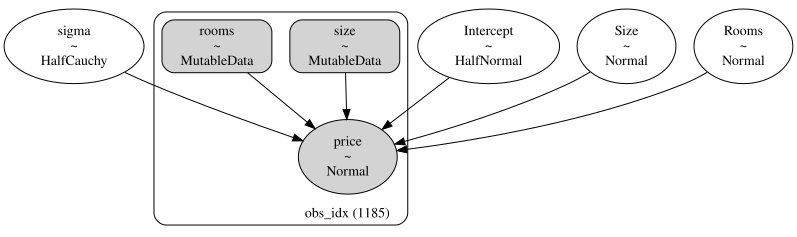

In [ ]:
pm.model_to_graphviz(model)

In [ ]:
az.plot_trace(idata, figsize=(10, 7));

In [ ]:
with model:
    pm.set_data({
        'size': dv['size'],
        'rooms': dv['rooms'],
    })
    # Generate posterior predictive samples
    ppd_dv = pm.sample_posterior_predictive(idata, predictions=True)

Sampling: [price]


In [ ]:
pred_price = (10**ppd_dv.predictions["price"]).mean(dim=["chain", "draw"]).data.round(0)
dv = dv.assign(pred_price=pred_price,
              residual = lambda d: d["price"] - dv["pred_price"]).loc[:, columns_order]
dv

,size,latitude,longitude,rooms,buildYear,price,pred_price,residual
0,73.0,55.681720,12.583391,2,1690,5045000.0,3305859.0,1762410.0
1,66.0,55.693832,12.534633,3,1911,3775000.0,3274310.0,491727.0
2,99.0,55.655476,12.505323,3,2020,4250000.0,4796932.0,-568807.0
3,42.0,55.682552,12.562237,1,1969,2920000.0,2123256.0,803055.0
4,78.0,55.705750,12.493167,1,1959,2450000.0,3213041.0,-775039.0
...,...,...,...,...,...,...,...,...
127,41.0,55.662650,12.606344,1,1940,2000000.0,2102966.0,-99455.0
128,98.0,55.653294,12.565753,4,2019,6000000.0,5142352.0,860013.0
129,88.0,55.694294,12.534460,4,1913,3795000.0,4559089.0,-776886.0
130,56.0,55.709373,12.564988,2,1934,2920000.0,2692533.0,215991.0


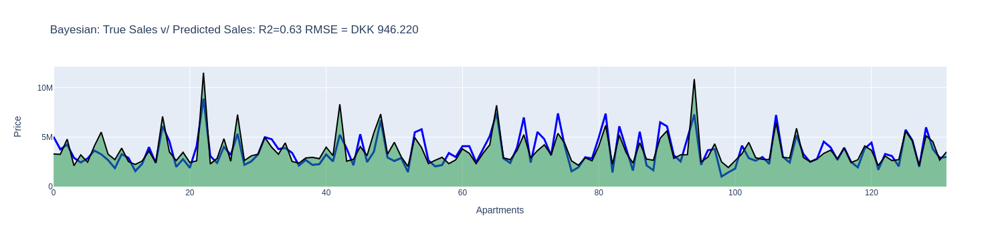

In [ ]:
R2 = r2_score(dv["price"], dv["pred_price"]).round(3)
RMSE = f'{int(mean_squared_error(y_true=dv["price"], y_pred=dv["pred_price"], squared=False)):,}'.replace(
    ",", "."
)


(
    dv.plot(
        kind="line",
        y="price",
        title=f"Bayesian: True Sales v/ Predicted Sales: {R2=} RMSE = DKK {RMSE}",
    )
    .update_traces(line=dict(color="blue", width=3))
    .update_layout(
        hovermode="x unified",
        xaxis_title="Apartments",
        yaxis_title="Price",
    )
    .add_traces(
        dv.plot(kind="area", y="pred_price")
        .update_traces(
            line=dict(color="black", width=2,),
            fill="tonexty",
            fillcolor='rgba(26,150,65,0.5)',
        )
        .data
    )
)

In [ ]:
with pm.Model() as model:
    size = pm.MutableData('size', dt['size'], dims="obs_idx")
    rooms = pm.MutableData('rooms', dt['rooms'].astype('category').cat.codes, dims="obs_idx")
    buildYear = pm.MutableData('buildYear', dt['buildYear'].astype('category').cat.codes, dims="obs_idx")
    latitude = pm.MutableData('latitude', dt['latitude'], dims="obs_idx")
    longitude = pm.MutableData('longitude', dt['longitude'], dims="obs_idx")
    
    # Priors
    beta_size = pm.Normal('beta_size', mu=0, sigma=10)
    beta_rooms = pm.Normal('beta_rooms', mu=0, sigma=10, shape=len(dt['rooms'].unique()),)
    beta_buildYear = pm.Normal('beta_buildYear', mu=0, sigma=10, shape=len(dt['buildYear'].unique()))
    beta_latitude = pm.Normal('beta_latitude', mu=0, sigma=10)
    beta_longitude = pm.Normal('beta_longitude', mu=0, sigma=10)
    sigma = pm.HalfNormal('sigma', sigma=10)

    # Linear model
    mu = (beta_size * size +
          beta_rooms[rooms] +
          beta_buildYear[buildYear] +
          beta_latitude * latitude +
          beta_longitude * longitude)

    # Likelihood
    log_price = pm.Normal('log_price', mu=mu, sigma=sigma, observed=np.log10(dt['price']), dims="obs_idx")

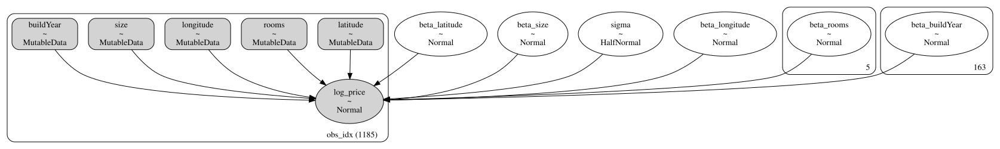

In [ ]:
pm.model_to_graphviz(model)

In [ ]:
with model:
    # Sampling
    trace = pm.sample(1000)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta_size, beta_rooms, beta_buildYear, beta_latitude, beta_longitude, sigma]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 442 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 1034 divergences after tuning. Increase `target_accept` or reparameterize.
Chain 0 reached the maximum tree depth. Increase `max_treedepth`, increase `target_accept` or reparameterize.
Chain 2 reached the maximum tree depth. Increase `max_treedepth`, increase `target_accept` or reparameterize.
Chain 3 reached the maximum tree depth. Increase `max_treedepth`, increase `target_accept` or reparameterize.


In [ ]:
az.plot_trace(trace);

In [ ]:
# Updating the model with new data (dv)
with model:
    pm.set_data({
        'size': dv['size'],
        'rooms': dv['rooms'].astype('category').cat.codes,
        'buildYear': dv['buildYear'].astype('category').cat.codes,
        'latitude': dv['latitude'],
        'longitude': dv['longitude']
    })
    # Generate posterior predictive samples
    ppd_dv = pm.sample_posterior_predictive(trace, predictions=True)

Sampling: [log_price]


In [ ]:
y_pred = (10**ppd_dv.predictions["log_price"]).mean(dim=["chain", "draw"]).data.round(0)

In [ ]:
dv.assign(pred_price=y_pred)

,size,latitude,longitude,price,rooms,buildYear,pred_price
0,73.0,55.681720,12.583391,5045000.0,2,1690,3670841.0
1,66.0,55.693832,12.534633,3775000.0,3,1911,2659468.0
2,99.0,55.655476,12.505323,4250000.0,3,2020,4443971.0
3,42.0,55.682552,12.562237,2920000.0,1,1969,2572922.0
4,78.0,55.705750,12.493167,2450000.0,1,1959,2895638.0
...,...,...,...,...,...,...,...
127,41.0,55.662650,12.606344,2000000.0,1,1940,2580152.0
128,98.0,55.653294,12.565753,6000000.0,4,2019,4405024.0
129,88.0,55.694294,12.534460,3795000.0,4,1913,4902592.0
130,56.0,55.709373,12.564988,2920000.0,2,1934,3707158.0


In [ ]:
mean_squared_error(dv["price"], y_pred, squared=False), r2_score(dv["price"], y_pred)

(1301401.9362769555, 0.30030821283253595)